# CNN Trainig Templete
## Based on Tensorlfow - CNN MNIST example
https://github.com/tensorflow/tensorflow/blob/r1.6/tensorflow/examples/tutorials/layers/cnn_mnist.py

## 필요한 library 호출

In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import numpy as np
import tensorflow as tf

import cv2

import os

tf.logging.set_verbosity(tf.logging.INFO)


/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


## CNN model 설계
현재는 MNIST에 사용된 것으로, 추후 그물 찢김에 적용하기 위해 수정 필요

### Input Layer
Input Image Pixel: 28x28  
Color channel: 1 (grayscale)  

### 1st Conv Layer
Num of filter: 32  
Kernel size: 5x5  
Padding: Same  
Activation: ReLU  
Padding same은 입/출력이 같은 크기를 갖도록 padding하는 것  

### 1st Pooling Layer
Max pooling  
Size: 2x2  
Stride: 2  
Max pooling 시 size의 폭과 stride가 같으면 pooling window가 서로 겹치지 않음  

### 2nd Conv Layer
Num of filter: 64  
Kernel size: 5x5  
Padding: Same  
Activation: ReLU  

### 2nd Pooling Layer
Max pooling  
Size: 2x2  
Stride: 2  


### 3rd, 4th, 5th


### Dense Layer
Fully connected  

### Drop out
Rate: 0.4 (40%)  
훈련 중 40%의 connection이 임의로 제거됨  
Overfitting 방지  
뇌의학에서도 학습을 반복할수록 사람 뇌의 뉴런은 일부 connection이 끊어지면서 더 확실하게 학습한다고 함  

### Logits Layer
Binaray classification  

### Training
Loss function: Softmax Cross Entropy  
Optimizer: Gradient Descent  
Learning rate: 0.001  

In [2]:
def cnn_model_fn(features, labels, mode):
    
    """Model function for CNN."""
    # Input Layer
    # Reshape X to 4-D tensor: [batch_size, height, width, channels]
    # Our Fishing net image size is 640x480 and 3-channel (RGB)
    input_layer = tf.reshape(features["x"], [-1, 480, 640, 3])

    # Convolutional Layer #1
    # Computes 48 features using a 5x5 filter with ReLU activation.
    # Padding is added to preserve width and height.
    # Input Tensor Shape: [batch_size, 480, 640, 3]
    # Output Tensor Shape: [batch_size, 480, 640, 48]
    conv1 = tf.layers.conv2d(
        
        inputs=input_layer,
        filters=48,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv1.shape)

    # Pooling Layer #1
    # First max pooling layer with a 2x2 filter and stride of 2
    # Input Tensor Shape: [batch_size, 480, 640, 48]
    # Output Tensor Shape: [batch_size, 240, 320, 48]
    pool1 = tf.layers.max_pooling2d(inputs=conv1, pool_size=[2, 2], strides=2)
    print(pool1.shape)

    # Convolutional Layer #2
    # Computes 96 features using a 5x5 filter.
    # Padding is added to preserve width and height.
    # Input Tensor Shape: [batch_size, 240, 320, 48]
    # Output Tensor Shape: [batch_size, 240, 320, 96]
    conv2 = tf.layers.conv2d(
        inputs=pool1,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv2.shape)

    # Pooling Layer #2
    # Second max pooling layer with a 2x2 filter and stride of 2
    # Input Tensor Shape: [batch_size, 240, 320, 96]
    # Output Tensor Shape: [batch_size, 120, 160, 96]
    pool2 = tf.layers.max_pooling2d(inputs=conv2, pool_size=[2, 2], strides=2)
    print(pool2.shape)

    
    
    
    # Input Tensor Shape: [batch_size, 120, 160, 96]
    # Output Tensor Shape: [batch_size, 120, 160, 96]    
    conv3 = tf.layers.conv2d(
        inputs=pool2,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv3.shape)
    
    # Input Tensor Shape: [batch_size, 120, 160, 96]
    # Output Tensor Shape: [batch_size, 60, 80, 96]
    pool3 = tf.layers.max_pooling2d(inputs=conv3, pool_size=[2, 2], strides=2)
    print(pool3.shape)
    
    
    
    # Input Tensor Shape: [batch_size, 60, 80, 96]
    # Output Tensor Shape: [batch_size, 60, 80, 96]    
    conv4 = tf.layers.conv2d(
        inputs=pool3,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv4.shape)
    
    # Input Tensor Shape: [batch_size, 60, 80, 96]
    # Output Tensor Shape: [batch_size, 30, 40, 96]
    pool4 = tf.layers.max_pooling2d(inputs=conv4, pool_size=[2, 2], strides=2)
    print(pool4.shape)
    
    
    
    # Input Tensor Shape: [batch_size, 30, 40, 96]
    # Output Tensor Shape: [batch_size, 30, 40, 96]    
    conv5 = tf.layers.conv2d(
        inputs=pool4,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv5.shape)
    
    # Input Tensor Shape: [batch_size, 30, 40, 96]
    # Output Tensor Shape: [batch_size, 15, 20, 96]
    pool5 = tf.layers.max_pooling2d(inputs=conv5, pool_size=[2, 2], strides=2)
    print(pool5.shape)
    
    
    
    
    # Flatten tensor into a batch of vectors
    # Input Tensor Shape: [batch_size, 15, 20, 96]
    # Output Tensor Shape: [batch_size, 15 * 20 * 96]
    pool5_flat = tf.reshape(pool5, [-1, 15 * 20 * 96])
    print(pool5_flat.shape)


    # Dense Layer
    # Densely connected layer with 1024 neurons
    # Input Tensor Shape: [batch_size, 15 * 20 * 96]
    # Output Tensor Shape: [batch_size, 1024]
    dense = tf.layers.dense(inputs=pool5_flat, units=1024, activation=tf.nn.relu)
    print(dense.shape)

    # Add dropout operation; 0.6 probability that element will be kept
    dropout = tf.layers.dropout(
        inputs=dense, rate=0.4, training=mode == tf.estimator.ModeKeys.TRAIN)

    # Logits layer
    # Input Tensor Shape: [batch_size, 1024]
    # Output Tensor Shape: [batch_size, 1]
    logits = tf.layers.dense(inputs=dropout, units=2)
    print(logits.shape)

    predictions = {
        # Generate predictions (for PREDICT and EVAL mode)
        "classes": tf.argmax(input=logits, axis=1),
        # Add `softmax_tensor` to the graph. It is used for PREDICT and by the
        # `logging_hook`.
        "probabilities": tf.nn.softmax(logits, name="softmax_tensor")
    }
    if mode == tf.estimator.ModeKeys.PREDICT:
        return tf.estimator.EstimatorSpec(mode=mode, predictions=predictions)

    # Calculate Loss (for both TRAIN and EVAL modes)
    loss = tf.losses.sparse_softmax_cross_entropy(labels=labels, logits=logits)
    # sparse_softmax_cross_entropy cannot use one-hot encoding
    
    #loss = tf.nn.sigmoid_cross_entropy_with_logits(labels=labels, logits=logits)

    # Configure the Training Op (for TRAIN mode)
    if mode == tf.estimator.ModeKeys.TRAIN:
        optimizer = tf.train.GradientDescentOptimizer(learning_rate=0.001)
        train_op = optimizer.minimize(
            loss=loss,
            global_step=tf.train.get_global_step())
        return tf.estimator.EstimatorSpec(mode=mode, loss=loss, train_op=train_op)

    # Add evaluation metrics (for EVAL mode)
    eval_metric_ops = {
        "accuracy": tf.metrics.accuracy(
            labels=labels, predictions=predictions["classes"])}
    return tf.estimator.EstimatorSpec(
        mode=mode, loss=loss, eval_metric_ops=eval_metric_ops)

## Code Run


### Training
Batch size: 128  
Epoch: 5  
Shuffle: True  
Step: 20000

## Loading dataset
Load dataset and split them into training data and evaluation data

In [3]:
# torn: 0-1484
# untorn: 0-1779
num_torn = 1485
num_untorn = 1780
total_pix = 480*640*3

torn_data = np.zeros((num_torn, total_pix), dtype=np.float32)
print(torn_data.shape)
untorn_data = np.zeros((num_untorn, total_pix), dtype=np.float32)

(1485, 921600)


In [4]:
torn_idx = np.arange(num_torn)
untorn_idx = np.arange(num_untorn)
print(torn_idx)

np.random.shuffle(torn_idx)
np.random.shuffle(untorn_idx)

print(torn_idx)

[   0    1    2 ... 1482 1483 1484]
[ 801  278  351 ...  586  946 1406]


In [5]:
for i in range(num_torn):
    img = cv2.imread("/dataset/torn/img-%04d.png" % torn_idx[i]).flatten()
    torn_data[i][:] = img

In [6]:
for i in range(num_untorn):
    img = cv2.imread("/dataset/untorn/img-%04d.png" % untorn_idx[i]).flatten()
    untorn_data[i][:] = img

In [7]:
torn_label = np.full((num_torn,1), 1, dtype=np.float32)
untorn_label = np.full((num_untorn,1), 1, dtype=np.float32)

In [8]:
# 80% training, 20% evaluation
tr_rate = 0.8
num_tr_torn = int(tr_rate * num_torn)
num_ev_torn = num_torn - num_tr_torn
print(num_tr_torn, num_ev_torn)

num_tr_untorn = int(tr_rate * num_untorn)
num_ev_untorn = num_untorn - num_tr_untorn
print(num_tr_untorn, num_ev_untorn)

tr_torn = torn_data[:num_tr_torn][:]
ev_torn = torn_data[num_tr_torn:][:]
print(tr_torn.shape)
print(ev_torn.shape)

tr_untorn = untorn_data[:num_tr_untorn][:]
ev_untorn = untorn_data[num_tr_untorn:][:]
print(tr_untorn.shape)
print(ev_untorn.shape)



tr_data = np.append(tr_torn, tr_untorn, axis=0)
print(tr_data.shape)
ev_data = np.append(ev_torn, ev_untorn, axis=0)
print(ev_data.shape)

tr_label = np.append(np.full((num_tr_torn), 1, dtype=np.int32), np.full((num_tr_untorn), 0, dtype=np.int32))
ev_label = np.append(np.full((num_ev_torn), 1, dtype=np.int32), np.full((num_ev_untorn), 0, dtype=np.int32))
print(tr_label.shape[0], ev_label.shape[0])

1188 297
1424 356
(1188, 921600)
(297, 921600)
(1424, 921600)
(356, 921600)
(2612, 921600)
(653, 921600)
2612 653


In [9]:
shuf1 = np.arange(tr_label.shape[0])
np.random.shuffle(shuf1)
print(shuf1)

shuf2 = np.arange(ev_label.shape[0])
np.random.shuffle(shuf2)
print(shuf2)

tr_data_sh = np.zeros((tr_data.shape), dtype=np.float32)
tr_label_sh = np.zeros((tr_label.shape), dtype=np.int32)
ev_data_sh = np.zeros((ev_data.shape), dtype=np.float32)
ev_label_sh = np.zeros((ev_label.shape), dtype=np.int32)


for i in range(tr_label.shape[0]):
    tr_data_sh[i][:] = tr_data[shuf1[i]][:]
    tr_label_sh[i] = tr_label[shuf1[i]]
    
for i in range (ev_label.shape[0]):
    ev_data_sh[i][:] = ev_data[shuf2[i]][:]
    ev_label_sh[i] = ev_label[shuf2[i]]

[2031 1833  125 ... 1340  734 1222]
[586 359 103  54 296 205  81 312 288 225 434 192 283 282 629  57 493 536
 189 611 106 318  68 465 167 264 244  77  99 410 576  98 370 495 407 470
 337 132 171 384 100 135 630 587 423 436 236 602 156 166  20 119 646  41
 412 173 397  55 117  72 517 429 186  31 243 245 126 331 357 310 404 321
 344 450 360 471 545 353 319 552 327  38 391 356 348 369 574 529 631 608
 345 285 165 478 163  17 308 413 503 351 349   5 437 215 206 182 157  40
 464  87 569 619  92 623 343 122 279 516 175 372  65 387  30 304 583 226
 624 567 640 298 213 392 525 170 463 152 618 110 570 651 458 400 401 535
 229 466 286  10 275 214 158 168 559  95 290   0  90 247  69 620 219 644
 447 648 652 287 506 492   6  23 491 421 459 610 399 289 420 418 142 607
 594 544 116 207 599 128 328 603 572  82 191 438  19 160 432 514 519 500
 124  84 563 596 271  67  88   4 589 650 108 102 581 159 548 241 553 338
 284 612 147 267 405 497 510 448 256 306 561 431 605 374 433 129 237 125
 295 485 591 61

In [10]:
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.5
session = tf.Session(config=config)

# Create the Estimator
net_classifier = tf.estimator.Estimator(
    model_fn=cnn_model_fn, model_dir="./models/")

# Set up logging for predictions
# Log the values in the "Softmax" tensor with label "probabilities"
tensors_to_log = {"probabilities": "softmax_tensor"}
logging_hook = tf.train.LoggingTensorHook(
    tensors=tensors_to_log, every_n_iter=50)

batch_s = 1
epochs = 5
tr_steps = int(tr_data.shape[0]/batch_s*epochs)
in_steps = 1

for d in ['/device:GPU:0', '/device:GPU:1']:
    with tf.device(d):

        # Train the model
        train_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": tr_data},
            y=tr_label,
            batch_size=batch_s,
            num_epochs=epochs,
            shuffle=True)
        net_classifier.train(
            input_fn=train_input_fn,
            steps=20000,
            hooks=[logging_hook])

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_session_config': None, '_log_step_count_steps': 100, '_global_id_in_cluster': 0, '_model_dir': './models/', '_num_ps_replicas': 0, '_save_summary_steps': 100, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7f5000197a58>, '_is_chief': True, '_master': '', '_evaluation_master': '', '_task_type': 'worker', '_save_checkpoints_secs': 600, '_keep_checkpoint_every_n_hours': 10000, '_save_checkpoints_steps': None, '_tf_random_seed': None, '_service': None, '_num_worker_replicas': 1, '_keep_checkpoint_max': 5, '_task_id': 0}
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restor

INFO:tensorflow:loss = 0.04387812, step = 17595 (2.859 sec)
INFO:tensorflow:probabilities = [[0.88839185 0.11160816]] (1.421 sec)
INFO:tensorflow:global_step/sec: 35.1781
INFO:tensorflow:probabilities = [[0.95806456 0.04193542]] (1.422 sec)
INFO:tensorflow:loss = 0.042840146, step = 17695 (2.842 sec)
INFO:tensorflow:probabilities = [[0.510656 0.489344]] (1.414 sec)
INFO:tensorflow:global_step/sec: 35.1244
INFO:tensorflow:probabilities = [[0.85878444 0.14121553]] (1.433 sec)
INFO:tensorflow:loss = 0.15223734, step = 17795 (2.847 sec)
INFO:tensorflow:probabilities = [[0.999723   0.00027695]] (1.380 sec)
INFO:tensorflow:global_step/sec: 35.9832
INFO:tensorflow:probabilities = [[0.9490821  0.05091797]] (1.399 sec)
INFO:tensorflow:loss = 0.052260008, step = 17895 (2.779 sec)
INFO:tensorflow:probabilities = [[0.91029173 0.08970823]] (1.432 sec)
INFO:tensorflow:global_step/sec: 34.3426
INFO:tensorflow:probabilities = [[0.9822375 0.0177625]] (1.480 sec)
INFO:tensorflow:loss = 0.017922126, step

INFO:tensorflow:probabilities = [[1. 0.]] (1.427 sec)
INFO:tensorflow:global_step/sec: 34.8597
INFO:tensorflow:probabilities = [[0.41920683 0.58079314]] (1.442 sec)
INFO:tensorflow:loss = 0.5433606, step = 21095 (2.869 sec)
INFO:tensorflow:probabilities = [[0.9777348  0.02226513]] (1.450 sec)
INFO:tensorflow:global_step/sec: 34.8352
INFO:tensorflow:probabilities = [[0.999793   0.00020703]] (1.421 sec)
INFO:tensorflow:loss = 0.0002070451, step = 21195 (2.871 sec)
INFO:tensorflow:probabilities = [[0.48542625 0.51457375]] (1.478 sec)
INFO:tensorflow:global_step/sec: 34.3691
INFO:tensorflow:probabilities = [[0.17991641 0.8200836 ]] (1.431 sec)
INFO:tensorflow:loss = 0.198349, step = 21295 (2.910 sec)
INFO:tensorflow:probabilities = [[0.03774107 0.962259  ]] (1.413 sec)
INFO:tensorflow:global_step/sec: 34.8576
INFO:tensorflow:probabilities = [[0.11680942 0.88319063]] (1.455 sec)
INFO:tensorflow:loss = 0.12421424, step = 21395 (2.868 sec)
INFO:tensorflow:probabilities = [[0.10146796 0.898532

INFO:tensorflow:global_step/sec: 33.5399
INFO:tensorflow:probabilities = [[0.21711072 0.78288925]] (1.465 sec)
INFO:tensorflow:loss = 0.24476406, step = 24495 (2.980 sec)
INFO:tensorflow:probabilities = [[0.10841174 0.8915883 ]] (1.444 sec)
INFO:tensorflow:global_step/sec: 34.4148
INFO:tensorflow:probabilities = [[0.00001792 0.9999821 ]] (1.461 sec)
INFO:tensorflow:loss = 1.7881233e-05, step = 24595 (2.906 sec)
INFO:tensorflow:probabilities = [[1. 0.]] (1.456 sec)
INFO:tensorflow:global_step/sec: 34.1403
INFO:tensorflow:probabilities = [[0.11444245 0.8855576 ]] (1.474 sec)
INFO:tensorflow:loss = 0.1215378, step = 24695 (2.929 sec)
INFO:tensorflow:probabilities = [[0.985333   0.01466693]] (1.446 sec)
INFO:tensorflow:global_step/sec: 34.2848
INFO:tensorflow:probabilities = [[0.0085209 0.9914791]] (1.471 sec)
INFO:tensorflow:loss = 0.008557436, step = 24795 (2.918 sec)
INFO:tensorflow:probabilities = [[1. 0.]] (1.448 sec)
INFO:tensorflow:global_step/sec: 34.657
INFO:tensorflow:probabiliti

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-27754
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Saving checkpoints for 27755 into ./models/model.ckpt.
INFO:tensorflow:probabilities = [[0.8012471  0.19875284]]
INFO:tensorflow:loss = 1.6156932, step = 27755
INFO:tensorflow:probabilities = [[0.19590777 0.8040922 ]] (1.547 sec)
INFO:tensorflow:global_step/sec: 33.8453
INFO:tensorflow:probabilities = [[0.99512285 0.00487721]] (1.409 sec)
INFO:tensorflow:loss = 0.0048890803, step = 27855 (2.956 sec)
INFO:tensorflow:probabilities = [[0.63863796 0.361362  ]] (1.467 sec)
INFO:tensorflow:global_step/sec: 34.448
INFO:tensorflow:probabilities = [[0.63073283 0.36926714]] (1.435 sec)
INFO:tensorflow:loss = 0.4608729, step = 27955 (2.901 sec)
INFO:tensorflow:probabilities = [[1. 0.]] (1.423 sec)
INFO:tensorflow:g

INFO:tensorflow:probabilities = [[0.2742603  0.72573966]] (1.429 sec)
INFO:tensorflow:loss = 0.32056388, step = 31055 (2.872 sec)
INFO:tensorflow:probabilities = [[1. 0.]] (1.492 sec)
INFO:tensorflow:global_step/sec: 33.1209
INFO:tensorflow:probabilities = [[0.23460309 0.76539695]] (1.527 sec)
INFO:tensorflow:loss = 1.4498601, step = 31155 (3.020 sec)
INFO:tensorflow:probabilities = [[1.         0.00000003]] (1.467 sec)
INFO:tensorflow:global_step/sec: 34.2072
INFO:tensorflow:probabilities = [[0.9999995  0.00000046]] (1.457 sec)
INFO:tensorflow:loss = 4.7683704e-07, step = 31255 (2.923 sec)
INFO:tensorflow:probabilities = [[0.46014342 0.5398566 ]] (1.437 sec)
INFO:tensorflow:global_step/sec: 35.0312
INFO:tensorflow:probabilities = [[0.25207457 0.74792546]] (1.424 sec)
INFO:tensorflow:loss = 0.29045194, step = 31355 (2.860 sec)
INFO:tensorflow:probabilities = [[0.84635603 0.153644  ]] (1.407 sec)
INFO:tensorflow:global_step/sec: 34.9745
INFO:tensorflow:probabilities = [[0.99836 0.00164]

INFO:tensorflow:probabilities = [[0.48173004 0.5182699 ]] (1.460 sec)
INFO:tensorflow:global_step/sec: 34.4356
INFO:tensorflow:probabilities = [[0.00000563 0.9999944 ]] (1.443 sec)
INFO:tensorflow:loss = 5.6028207e-06, step = 34555 (2.903 sec)
INFO:tensorflow:probabilities = [[0.40046456 0.5995354 ]] (1.435 sec)
INFO:tensorflow:global_step/sec: 34.9033
INFO:tensorflow:probabilities = [[0.03117316 0.9688269 ]] (1.431 sec)
INFO:tensorflow:loss = 0.031669326, step = 34655 (2.866 sec)
INFO:tensorflow:probabilities = [[0.02385836 0.97614163]] (1.441 sec)
INFO:tensorflow:global_step/sec: 34.6608
INFO:tensorflow:probabilities = [[0.02527316 0.9747268 ]] (1.443 sec)
INFO:tensorflow:loss = 0.025598053, step = 34755 (2.884 sec)
INFO:tensorflow:probabilities = [[0.997644   0.00235603]] (1.442 sec)
INFO:tensorflow:global_step/sec: 34.6592
INFO:tensorflow:probabilities = [[0.02196459 0.97803545]] (1.444 sec)
INFO:tensorflow:loss = 0.022209374, step = 34855 (2.885 sec)
INFO:tensorflow:probabilities 

INFO:tensorflow:probabilities = [[0.10936959 0.89063036]] (1.451 sec)
INFO:tensorflow:loss = 0.11582577, step = 37955 (2.893 sec)
INFO:tensorflow:probabilities = [[0.76489437 0.2351056 ]] (1.442 sec)
INFO:tensorflow:global_step/sec: 35.1105
INFO:tensorflow:probabilities = [[0.22533649 0.7746635 ]] (1.406 sec)
INFO:tensorflow:loss = 0.25532654, step = 38055 (2.848 sec)
INFO:tensorflow:probabilities = [[1. 0.]] (1.441 sec)
INFO:tensorflow:global_step/sec: 34.6143
INFO:tensorflow:probabilities = [[0.07176793 0.9282321 ]] (1.449 sec)
INFO:tensorflow:loss = 0.07447347, step = 38155 (2.889 sec)
INFO:tensorflow:probabilities = [[0.00000019 0.99999976]] (1.440 sec)
INFO:tensorflow:global_step/sec: 35.0505
INFO:tensorflow:probabilities = [[0.00000362 0.9999964 ]] (1.413 sec)
INFO:tensorflow:loss = 3.5762723e-06, step = 38255 (2.853 sec)
INFO:tensorflow:probabilities = [[0.6269184  0.37308162]] (1.449 sec)
INFO:tensorflow:global_step/sec: 34.6193
INFO:tensorflow:probabilities = [[1. 0.]] (1.440 

In [29]:
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.7
session = tf.Session(config=config)

ev_results = np.zeros((len(ev_label), 1))
with tf.device('/device:GPU:2'):

    # Evaluate the model and print results
    for i in range(len(ev_label)):
        eval_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": ev_data_sh[i:i+1]},
            y=ev_label_sh[i:i+1],
            num_epochs=1,
            shuffle=False)
        eval_results = net_classifier.evaluate(input_fn=eval_input_fn)
        
        ev_results[i] = eval_results["accuracy"]

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:30
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-05:59:31
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 7.152555e-07
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:35
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-05:59:36
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0215069
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:40
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-05:59:40
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0010186012
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-

(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:45
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-05:59:45
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 1.6940439
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:45
INFO:tensorflow:Graph 

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-05:59:50
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.07307859
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evalua

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:54
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-05:59:55
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 2.011075
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:55
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluati

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-05:59:59
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-05:59:59
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 1.1920928e-07
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:00
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished eva

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:04
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:04
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.009411256
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:05
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evalu

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:09
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:09
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.00049638347
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:09
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished eva

INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:14
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:14
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 1.5497195e-06
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:14
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:14
INFO:ten

INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:19
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:19
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.055619013
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:19
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:19
INFO:tenso

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:24
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.015216459
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:24
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:24
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, gl

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:29
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 9.45285e-05
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:29
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:29
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, gl

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:33
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.17172608
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:34
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:34
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, glo

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:38
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.10097876
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:39
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:39
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, glo

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:43
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 0.75432384
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:43
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:44
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, glo

INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:48
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 0.79337436
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:48
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:48
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.087492645


INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:53
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.00015412574
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:53
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:53
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.039285783
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320,

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:58
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0769389
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:00:58
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:00:58
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.13327022
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)


INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:02
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.021534085
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:03
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:03
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.06919798
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:07
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 1.6983062
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:07
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:08
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 1.2009212
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:12
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:12
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:13
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.101155475
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120,

INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:17
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 1.12056105e-05
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:17
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:18
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.049838383
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60,

INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 5.0305054e-05
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:22
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:22
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 2.5912561
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 2

INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0017080017
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:27
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:27
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.09283072
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 2

INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.6240421
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:32
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:32
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.03315497
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 2880

INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 1.8708601
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:37
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 

INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0029216008
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:42
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:42
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 1.5003697
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28

INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.11024408
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:47
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:47
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.11299368
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 288

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:52
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:52
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.21201909
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:01:57
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:01:57
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0003486264
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:02
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:02
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.032464415
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-0

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:06
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:07
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.079601936
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-0

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:11
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:11
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.22290128
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04

(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:16
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:16
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.003733927
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:17
INFO:tensorflow:Grap

(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:21
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:21
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.08672375
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:22
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Rest

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:26
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:26
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 1.5263455
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:27
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluat

INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:31
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:31
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.13739485
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:31
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:32
INFO:tensor

INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:36
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:36
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:36
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:36
INFO:tensorflow:Sa

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:41
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 0.96752787
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:41
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:42
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, glo

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:46
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 1.4066597e-05
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:46
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:46
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, 

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:51
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.14850044
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:51
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:51
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, glo

INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:56
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.015101743
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:02:56
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:02:56
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.001344610

INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:01
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.3250448
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:01
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:01
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 4.1723165e-06

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:06
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.00018702188
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:06
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:07
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.024202606
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320,

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:11
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.069094084
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:11
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:12
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 1.8694141
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:16
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 0.8877244
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:16
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:16
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.1625289
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:21
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.022108868
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:21
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:21
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.2929099
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?

INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:26
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.22577234
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:26
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:26
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 1.9907753e-05
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 8

INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:31
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.00031752314
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:31
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:31
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.10768152
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 8

INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:36
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 8.344647e-07
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:36
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:36
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.14973381
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80

INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:41
INFO:tensorflow:Saving dict for global step 40814: accuracy = 0.0, global_step = 40814, loss = 0.93564415
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:41
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:41
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?,

INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.18834722
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:46
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:46
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.45854664
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 288

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:51
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:52
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 5.817244e-05
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-

(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:56
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./models/model.ckpt-40814
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-16-06:03:56
INFO:tensorflow:Saving dict for global step 40814: accuracy = 1.0, global_step = 40814, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-16-06:03:57
INFO:tensorflow:Graph was fi

In [31]:
print(np.mean(ev_results))

0.877488514548239


In [106]:
fail_idx = np.where(ev_results == 0)
print(fail_idx[0])
print(len(fail_idx[0]))

[  8  10  14  21  33  36  39  60  74  82  87  98 123 131 134 141 142 145
 162 171 176 180 192 202 207 223 226 240 241 255 256 263 269 271 277 280
 282 292 295 305 312 316 325 331 333 341 369 377 383 390 392 395 423 425
 433 459 462 463 469 496 501 504 510 513 525 527 532 542 547 553 594 596
 598 606 613 615 621 628 629 635]
80


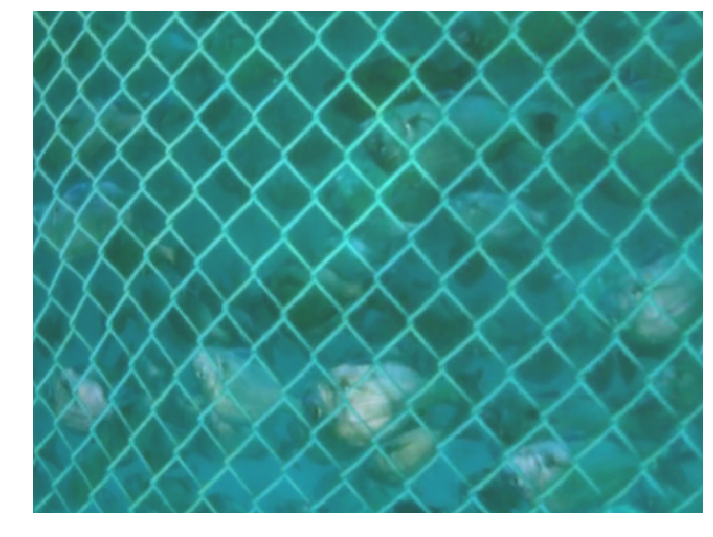

In [103]:
%matplotlib inline
import matplotlib.pyplot as plt

temp_img = ev_data_sh[501][:].reshape([480, 640, 3])
#temp_img = tf.reshape(ev_data_sh[33][:], [480, 640, 3])

temp_img = 255-temp_img

width = 12
height = 12
plt.figure(figsize=(width, height))
plt.axis("off")
plt.imshow(cv2.cvtColor(temp_img, cv2.COLOR_BGR2RGB))
plt.show()

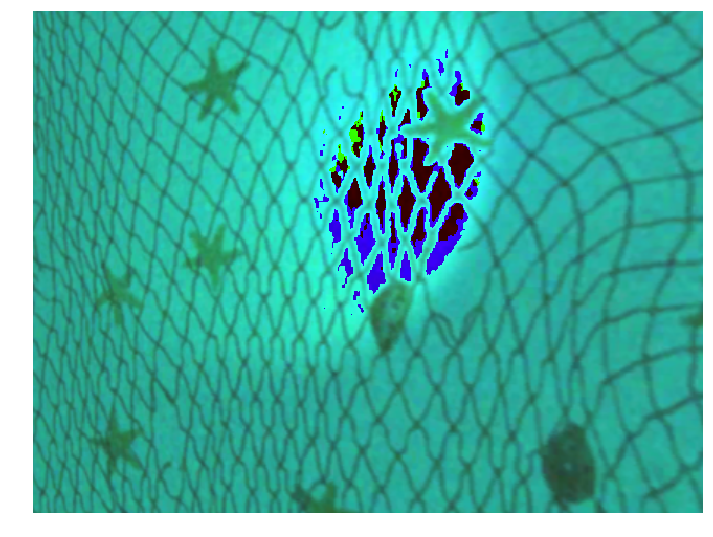

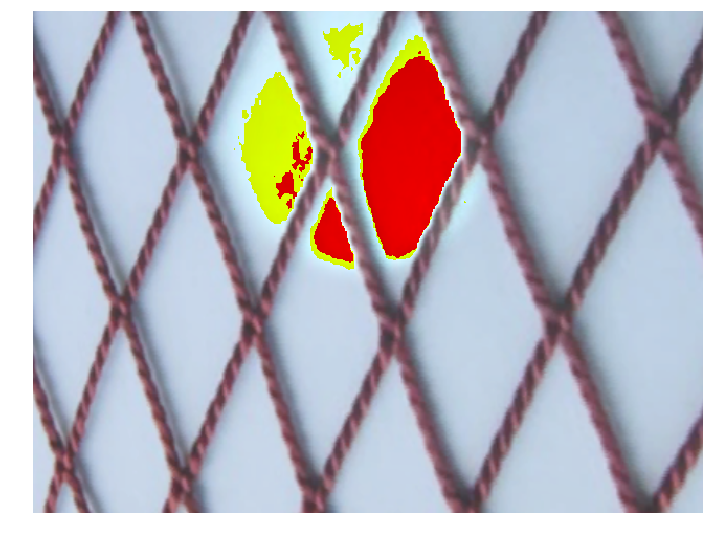

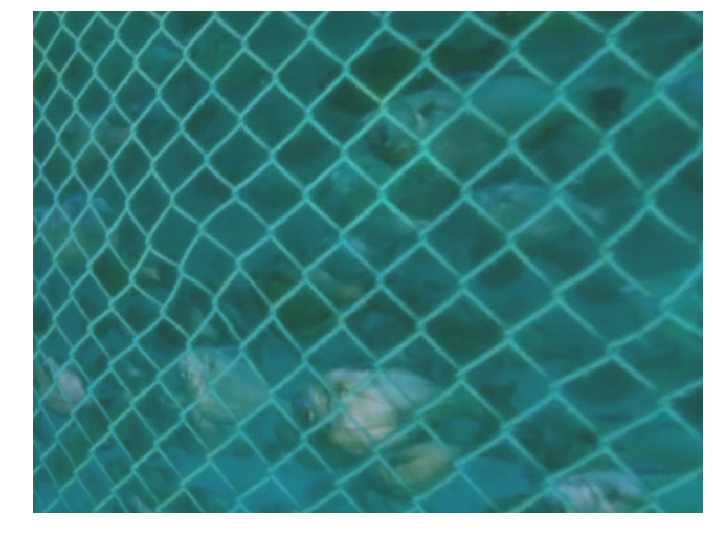

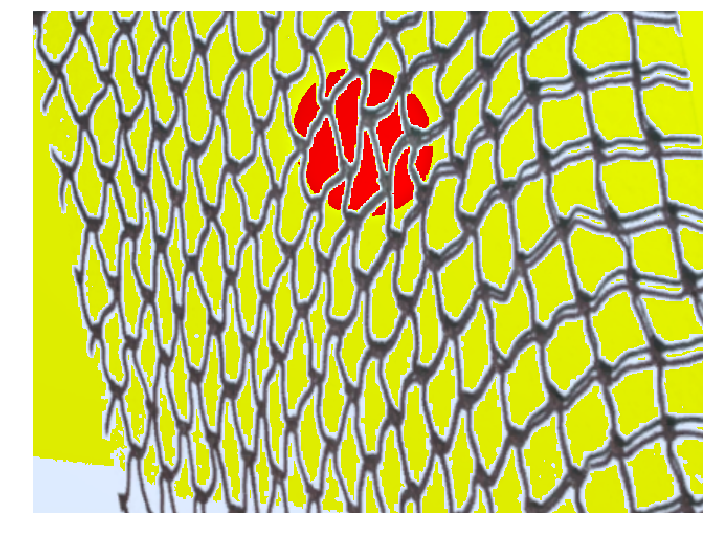

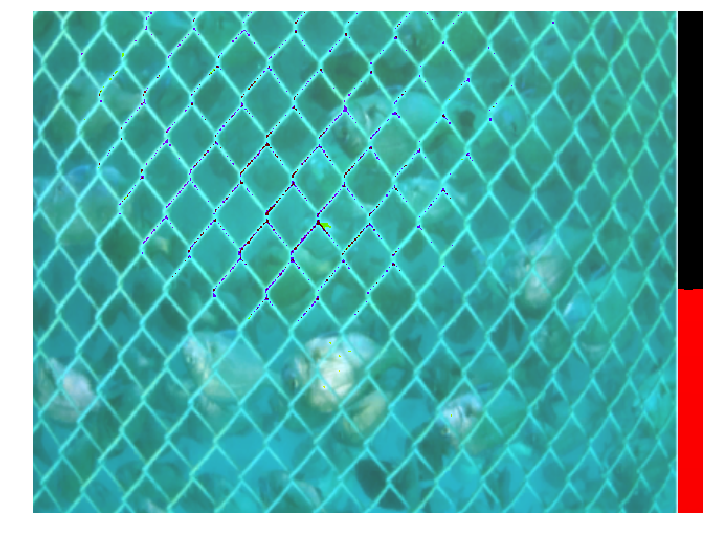

...

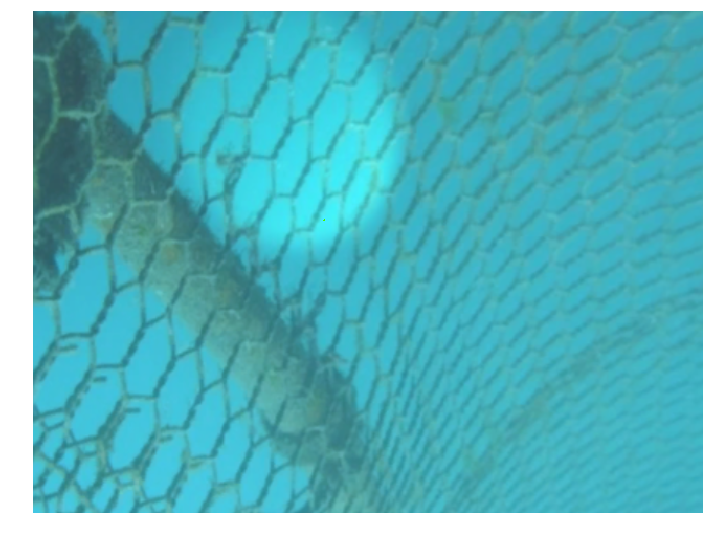

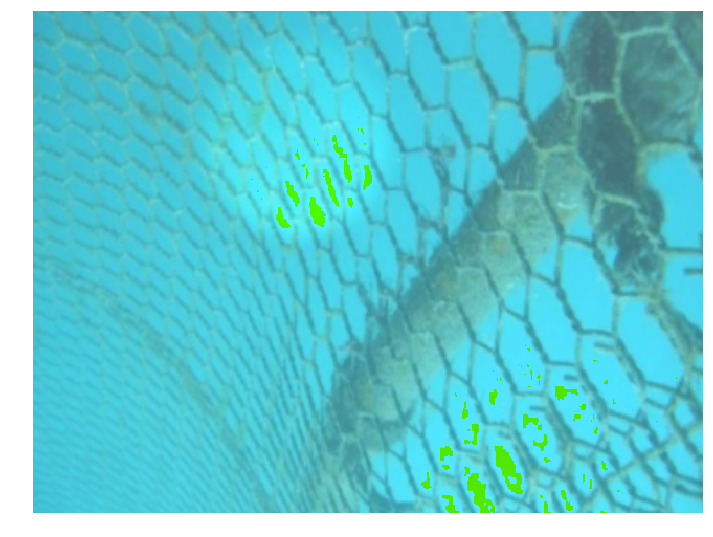

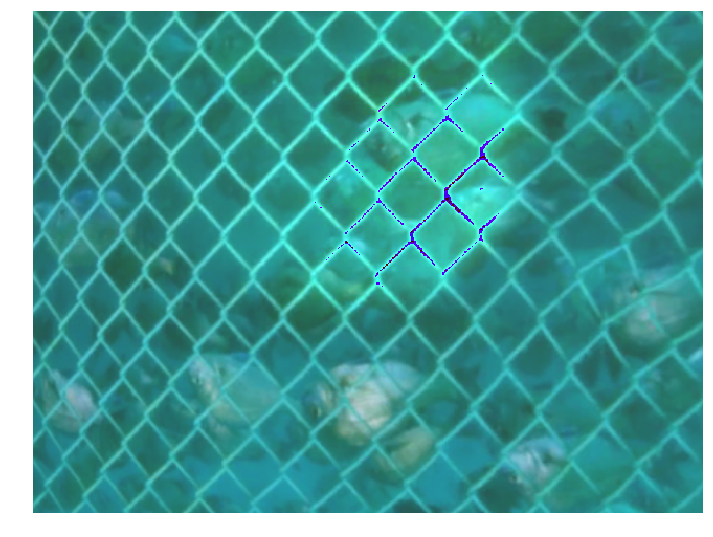

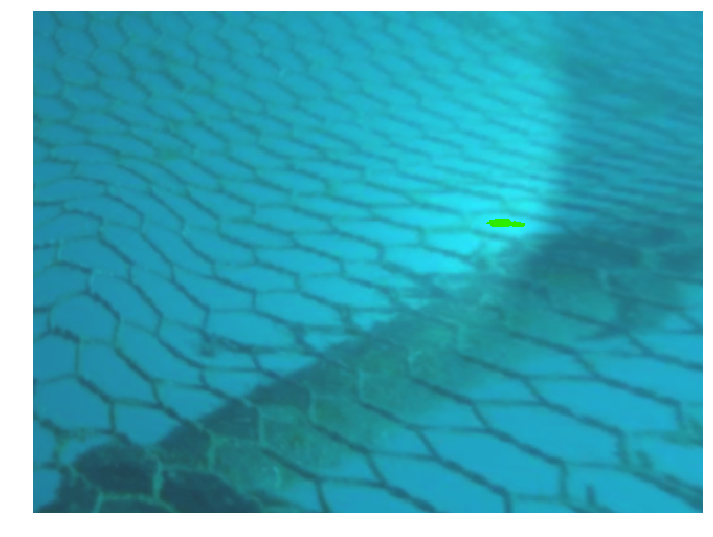

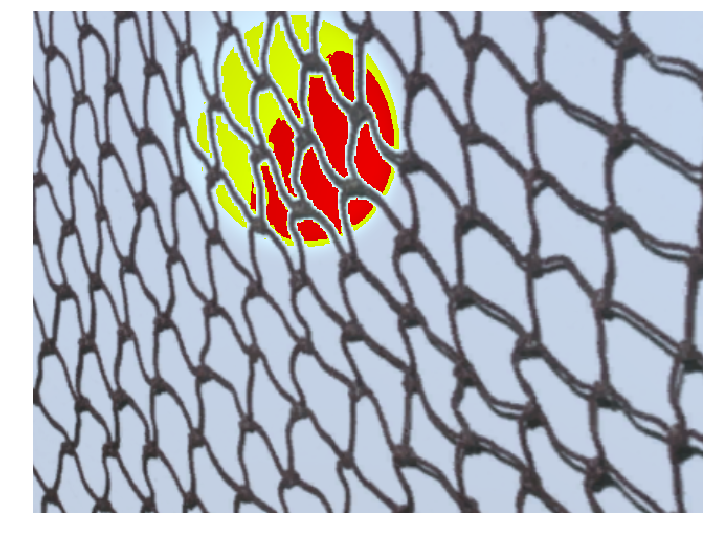

In [104]:
for i in range(len(fail_idx[0])):

    temp_img = ev_data_sh[fail_idx[0][i]][:].reshape([480, 640, 3])

    temp_img = 255-temp_img

    width = 12
    height = 12
    plt.figure(figsize=(width, height))
    plt.axis("off")
    plt.imshow(cv2.cvtColor(temp_img, cv2.COLOR_BGR2RGB))
    plt.show()

## Results
훈련 데이터셋 2612개  
검증 데이터셋 653개  
  
정확도 87.7%  
  
CNN layer 5개  
Training step: 40000회  
Batch size: 1  


## 오현석 교수님
오교수님 데이터셋으로 훈련시킨 CNN으로 우리 데이터셋 테스트 -> 44% 정확도  
우리 데이터셋으로 훈련시킨 CNN으로 오교수님 데이터셋 테스트 -> 60% 정확도  

LeNet 사용  
이미지 크기 64 x 64